In [1]:
import torch
from torch import nn
from torch.autograd import Variable

import torchvision.transforms as tfs
from torch.utils.data import DataLoader, sampler
from torchvision.datasets import MNIST

import numpy as np

import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec

%matplotlib inline
plt.rcParams['figure.figsize'] = (20.0, 16.0) # 设置画图的尺寸
plt.rcParams['image.interpolation'] = 'nearest'
#plt.rcParams['image.cmap'] = 'gray'

def show_images(images): # 定义画图工具
    #images = np.reshape(images, [images.shape[0], -1])
    print("###",images.shape)
    sqrtn = int(np.ceil(np.sqrt(images.shape[0])))
    sqrtimg = int(np.ceil(np.sqrt(images.shape[2])))
    #print(sqrtn,sqrtimg)
    fig = plt.figure(figsize=(sqrtn, sqrtn))
    gs = gridspec.GridSpec(sqrtn, sqrtn)
    gs.update(wspace=0.05, hspace=0.05)
    
    for i, img in enumerate(images):
        ax = plt.subplot(gs[i])
        plt.axis('off')
        ax.set_xticklabels([])
        ax.set_yticklabels([])
        ax.set_aspect('equal')
        #print("@@",img.shape)
        img=img.reshape(3,sqrtimg,sqrtimg)
        plt.imshow(img.transpose(1,2,0))
    return 

def preprocess_img(x):
    x = tfs.ToTensor()(x)
    return (x - 0.5) / 0.5

def deprocess_img(x):
    return (x + 1.0) / 2.0

In [2]:
from torchvision.datasets import CIFAR10
class ChunkSampler(sampler.Sampler): # 定义一个取样的函数
    """Samples elements sequentially from some offset. 
    Arguments:
        num_samples: # of desired datapoints
        start: offset where we should start selecting from
    """
    def __init__(self, num_samples, start=0):
        self.num_samples = num_samples
        self.start = start

    def __iter__(self):
        return iter(range(self.start, self.start + self.num_samples))

    def __len__(self):
        return self.num_samples

#NUM_TRAIN = 50000
#NUM_VAL = 5000

#NOISE_DIM = 96
batch_size = 64

def data_tf(x):
    x = np.array(x, dtype='float32')/255
    x = (x - 0.5) / 0.5 # 标准化，这个技巧之后会讲到
    x = x.transpose((2, 0, 1)) # 将 channel 放到第一维，只是 pytorch 要求的输入方式
    x = torch.from_numpy(x)
    return x 

train_set = CIFAR10('./data', train=True, transform=data_tf,download=True)
train_data = torch.utils.data.DataLoader(train_set, batch_size=64, shuffle=True)
test_set = CIFAR10('./data', train=False, transform=data_tf,download=True)
test_data = torch.utils.data.DataLoader(test_set, batch_size=64, shuffle=False)

a, a_label = train_set[0]
print(a.shape)
print(a_label)
print(train_data.__iter__().next()[0].shape)


Files already downloaded and verified
Files already downloaded and verified
torch.Size([3, 32, 32])
6
torch.Size([64, 3, 32, 32])


(64, 3, 1024)
### (64, 3, 1024)


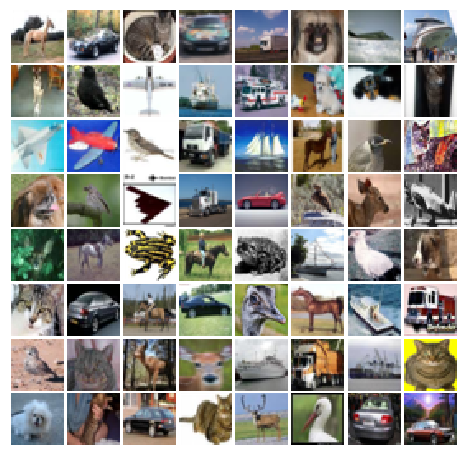

In [3]:
imgs = deprocess_img(train_data.__iter__().next()[0].view(64,3,32*32).numpy().squeeze())
print(imgs.shape)
show_images(imgs)








In [4]:
import torch.nn.functional as F
class build_dc_classifier(nn.Module):
    def __init__(self):
        super(build_dc_classifier, self).__init__()
        self.conv1 = nn.Conv2d(3, 64, kernel_size=5, stride=2, padding=2)
        self.conv2 = nn.Conv2d(64, 128, kernel_size=5, stride=2, padding=2)
        self.conv3 = nn.Conv2d(128, 256, kernel_size=5, stride=2, padding=2)
        self.bn1 = nn.BatchNorm2d(128)
        self.bn2 = nn.BatchNorm2d(256)
        self.fc1 = nn.Linear(4*4*256, 1)

    def forward(self, x):
        #print("$",x.shape)
        x = self.conv1(x)
        #print(x.shape)
        x = F.leaky_relu(x)

        x = self.conv2(x)
        #print(x.shape)
        x = self.bn1(x)
        x = F.leaky_relu(x)
        #print(x.shape)
        x = self.conv3(x)
        #print(x.shape)
        x = self.bn2(x)
        #print(x.shape)
        x = F.leaky_relu(x)
        #print(x.shape)
        x = x.view(-1, 4*4*256)
        x = self.fc1(x).view(-1)
        #print("@",x.shape)
        return x



In [5]:
#卷积生成网络
class build_dc_generator(nn.Module): 
     def __init__(self):
            super(build_dc_generator, self).__init__()
            self.fc1 = nn.Linear(300, 4*4*512)
            self.deconv1 = nn.ConvTranspose2d(512, 256, kernel_size=4, stride=2, padding=1)
            self.deconv2 = nn.ConvTranspose2d(256, 128, kernel_size=4, stride=2, padding=1)
            self.deconv3 = nn.ConvTranspose2d(128, 3, kernel_size=4, stride=2, padding=1)
            self.bn1 = nn.BatchNorm2d(512)
            self.bn2 = nn.BatchNorm2d(256)
            self.bn3 = nn.BatchNorm2d(128)

     def forward(self, z):
        
            x = self.fc1(z).view(-1, 512, 4, 4)
            x = self.bn1(x) 
            #print(x.shape)
            x = F.relu(x)
            x = F.leaky_relu(x)
            #print(x.shape)
            x = self.deconv1(x)
            #print(x.shape)
            x = self.bn2(x)
            x = F.leaky_relu(x)
            #print(x.shape)
            x = self.deconv2(x)
            #print(x.shape)
            x = self.bn3(x)
            x = F.leaky_relu(x)
            #print(x.shape)
            x = self.deconv3(x)
            #print("$",x.shape)
            x = F.tanh(x)
            return x

In [6]:
bce_loss = nn.BCEWithLogitsLoss()

def discriminator_loss(logits_real, logits_fake): # 判别器的 loss
    size = logits_real.shape[0]
    #print(1)
    true_labels = Variable(torch.ones(size, 1)).float().cuda()
    #print(11)
    false_labels = Variable(torch.zeros(size, 1)).float().cuda()
    #print(111)
    loss = bce_loss(logits_real.reshape(logits_real.shape[0],1), true_labels) + bce_loss(logits_fake.reshape(logits_fake.shape[0],1), false_labels)
    #print(1111)
    return loss

In [7]:
def generator_loss(logits_fake): # 生成器的 loss  
    size = logits_fake.shape[0]
    true_labels = Variable(torch.ones(size, 1)).float().cuda()
    loss = bce_loss(logits_fake.reshape(logits_fake.shape[0],1), true_labels.reshape(true_labels.shape[0],1))
    return loss

In [8]:
# 使用 adam 来进行训练，学习率是 3e-4, beta1 是 0.5, beta2 是 0.999
def get_optimizer(net):
    optimizer = torch.optim.Adam(net.parameters(), lr=3e-4, betas=(0.5, 0.999))
    return optimizer

In [9]:
def train_dc_gan(D_net, G_net, D_optimizer, G_optimizer, discriminator_loss, generator_loss, show_every=100, 
                noise_size=300, num_epochs=100):
    iter_count = 0
    for epoch in range(num_epochs):
        for x, _ in train_data:
            bs = x.shape[0]#64
            # 判别网络
            real_data = Variable(x).cuda() # 真实数据
            logits_real = D_net(real_data) # 判别网络得分
            
            sample_noise = (torch.rand(bs, noise_size) - 0.5) / 0.5 # -1 ~ 1 的均匀分布
            g_fake_seed = Variable(sample_noise).cuda()
            fake_images = G_net(g_fake_seed) # 生成的假的数据
            logits_fake = D_net(fake_images) # 判别网络得分
            d_total_error = discriminator_loss(logits_real, logits_fake) # 判别器的 loss
            D_optimizer.zero_grad()
            d_total_error.backward()
            D_optimizer.step() # 优化判别网络
            
            # 生成网络
            g_fake_seed = Variable(sample_noise).cuda()
            fake_images = G_net(g_fake_seed) # 生成的假的数据

            gen_logits_fake = D_net(fake_images)
            g_error = generator_loss(gen_logits_fake) # 生成网络的 loss
            G_optimizer.zero_grad()
            g_error.backward()
            G_optimizer.step() # 优化生成网络

            if (iter_count % show_every == 0):
                print('Iter: {}, D: {:.4}, G:{:.4}'.format(iter_count, d_total_error.item(), g_error.item()))
                imgs_numpy = deprocess_img(fake_images.data.cpu().view(64,3,32*32).numpy())
                
                show_images(imgs_numpy[0:64])
                plt.show()
                print()
            iter_count += 1

In [10]:
D_DC = build_dc_classifier().cuda()
G_DC = build_dc_generator().cuda()

D_DC_optim = get_optimizer(D_DC)
G_DC_optim = get_optimizer(G_DC)



D:\anaconda\lib\site-packages\torch\nn\functional.py:1339: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")


Iter: 0, D: 1.266, G:3.178
### (64, 3, 1024)


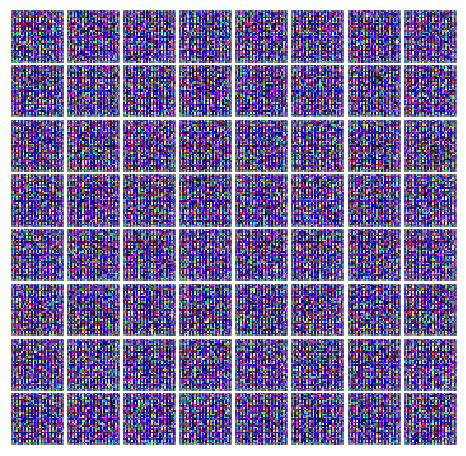


Iter: 100, D: 0.02431, G:11.65
### (64, 3, 1024)


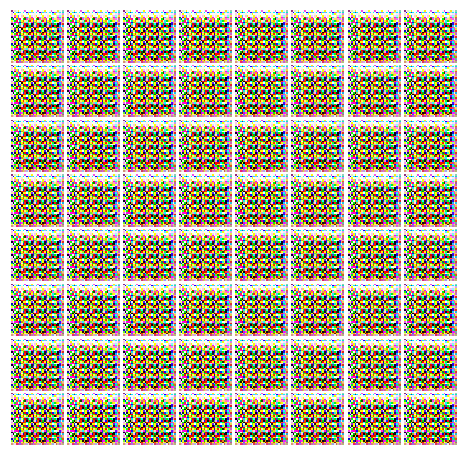


Iter: 200, D: 1.519, G:13.93
### (64, 3, 1024)


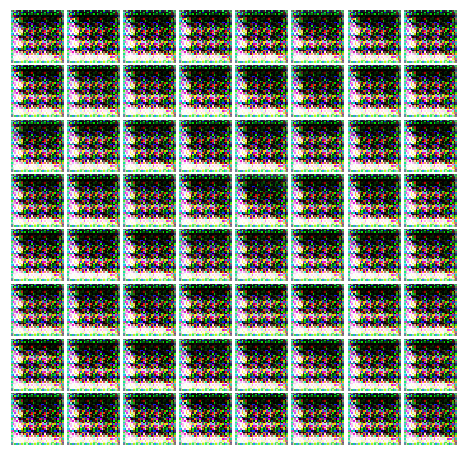


Iter: 300, D: 0.1619, G:3.794
### (64, 3, 1024)


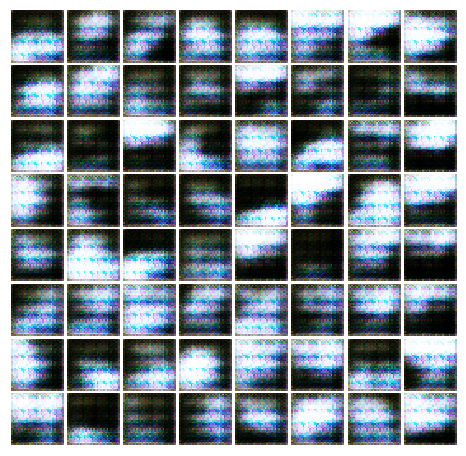


Iter: 400, D: 0.8152, G:2.347
### (64, 3, 1024)


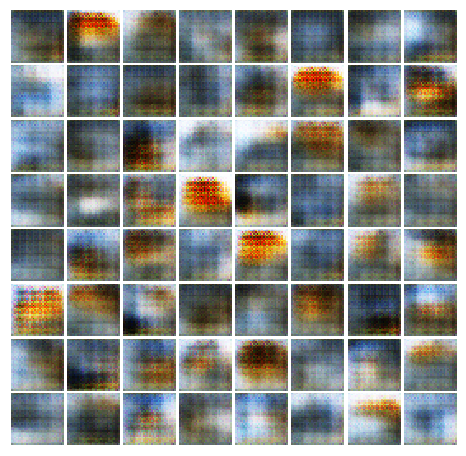


Iter: 500, D: 0.7043, G:2.3
### (64, 3, 1024)


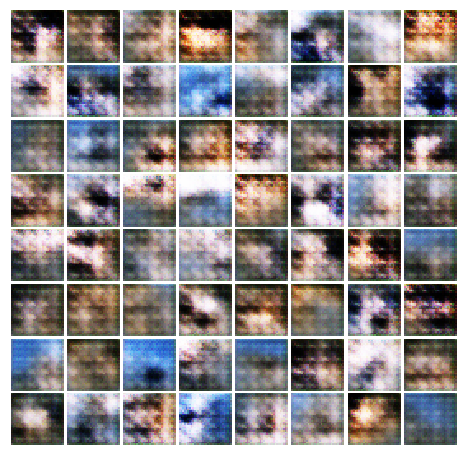


Iter: 600, D: 0.3825, G:2.96
### (64, 3, 1024)


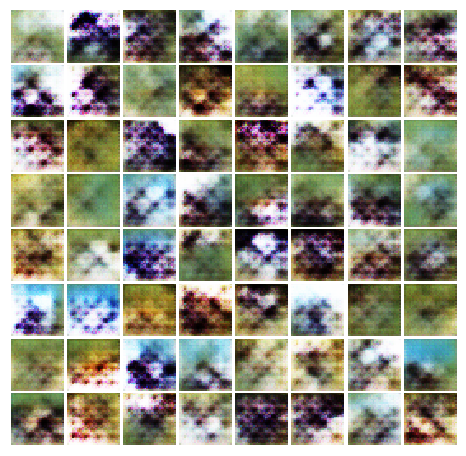


Iter: 700, D: 0.5488, G:3.094
### (64, 3, 1024)


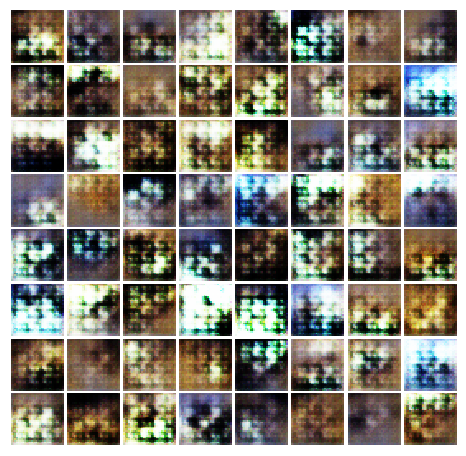


Iter: 800, D: 0.8725, G:6.767
### (64, 3, 1024)


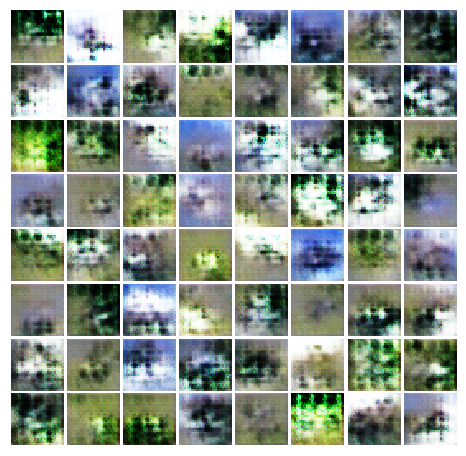


Iter: 900, D: 0.6774, G:4.591
### (64, 3, 1024)


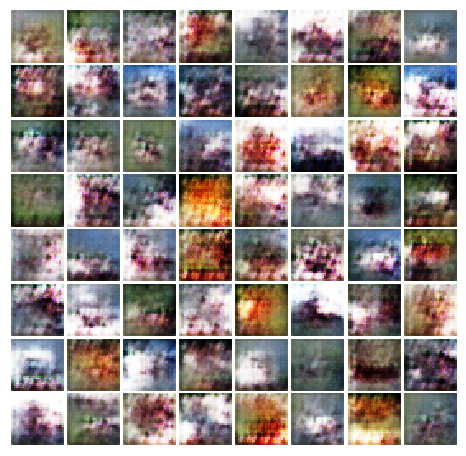


Iter: 1000, D: 0.1962, G:4.054
### (64, 3, 1024)


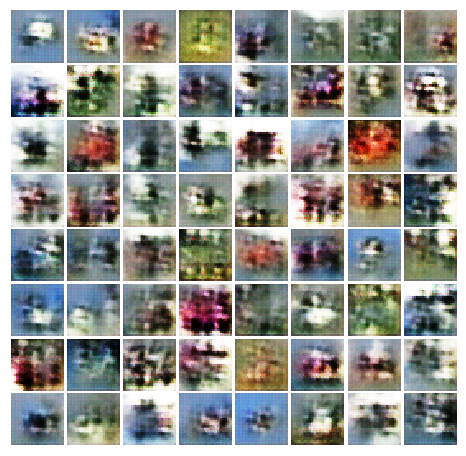


Iter: 1100, D: 0.484, G:2.735
### (64, 3, 1024)


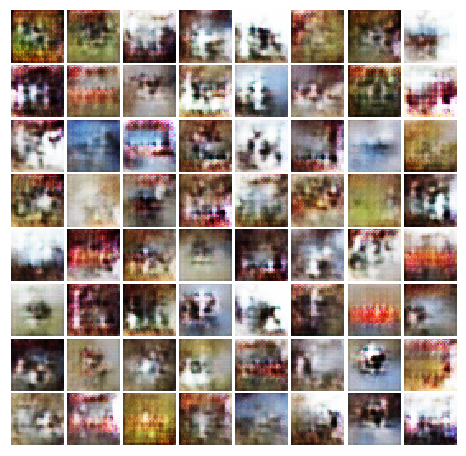


Iter: 1200, D: 0.7171, G:1.586
### (64, 3, 1024)


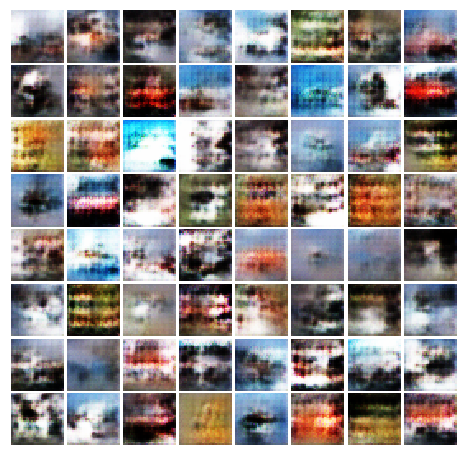


Iter: 1300, D: 1.466, G:2.918
### (64, 3, 1024)


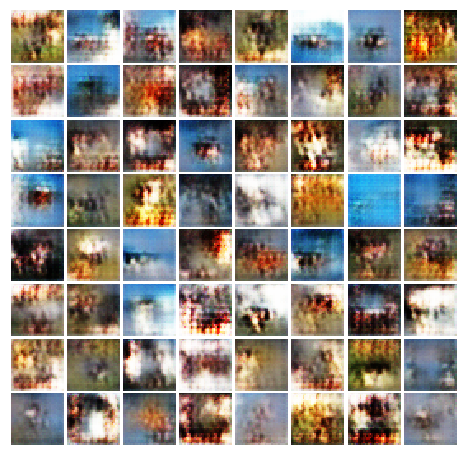


Iter: 1400, D: 0.5171, G:5.619
### (64, 3, 1024)


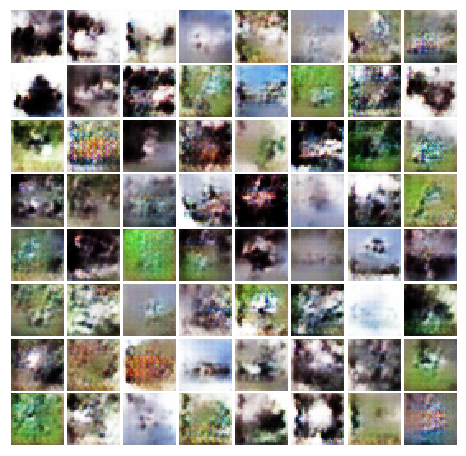


Iter: 1500, D: 0.519, G:3.758
### (64, 3, 1024)


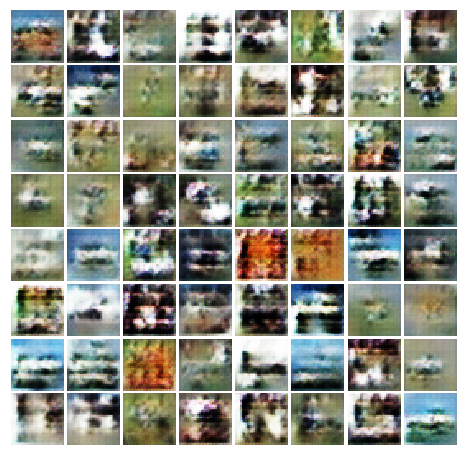


Iter: 1600, D: 0.4342, G:2.702
### (64, 3, 1024)


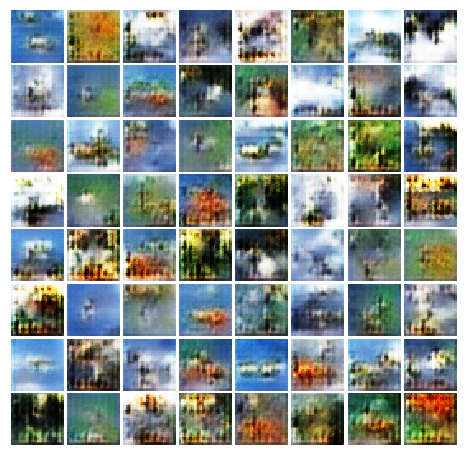


Iter: 1700, D: 0.4042, G:2.183
### (64, 3, 1024)


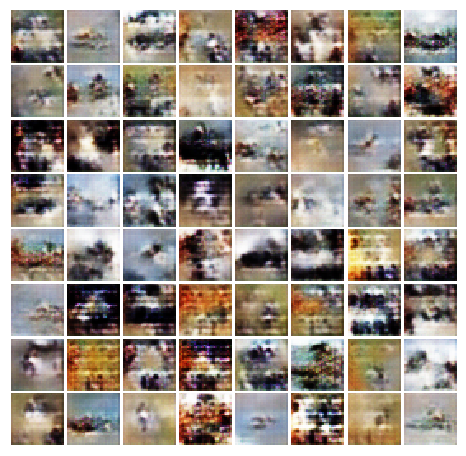


Iter: 1800, D: 0.3586, G:4.645
### (64, 3, 1024)


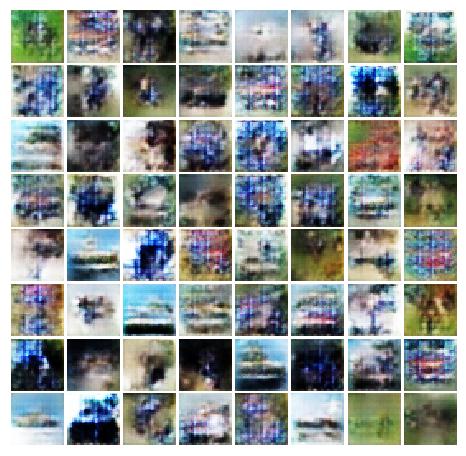


Iter: 1900, D: 0.3282, G:3.793
### (64, 3, 1024)


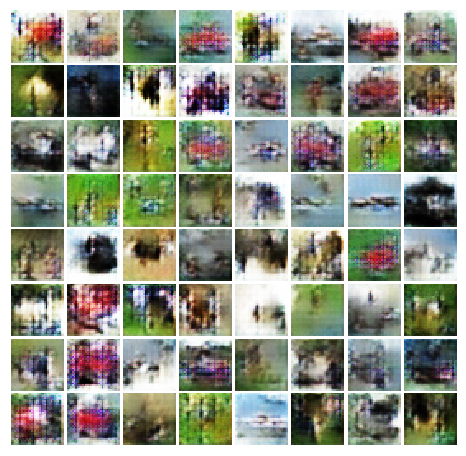


Iter: 2000, D: 0.4867, G:5.112
### (64, 3, 1024)


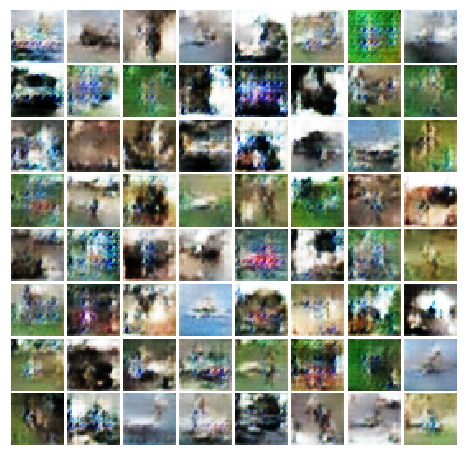


Iter: 2100, D: 0.2527, G:4.653
### (64, 3, 1024)


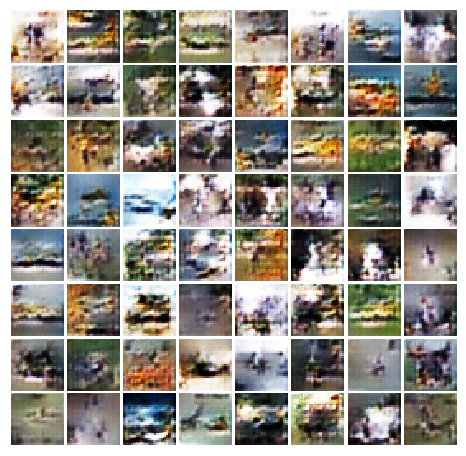


Iter: 2200, D: 0.6811, G:5.07
### (64, 3, 1024)


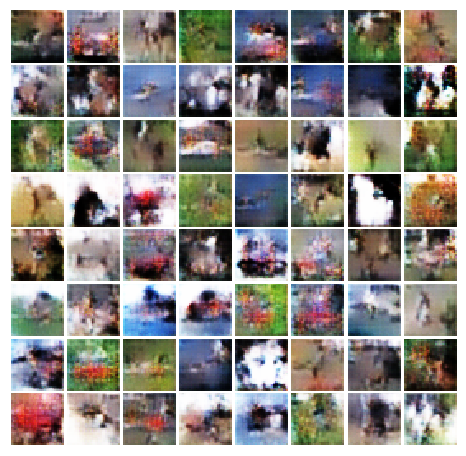


Iter: 2300, D: 0.3725, G:3.045
### (64, 3, 1024)


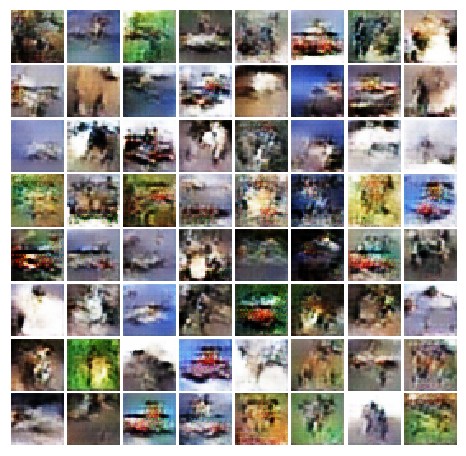


Iter: 2400, D: 0.4256, G:6.999
### (64, 3, 1024)


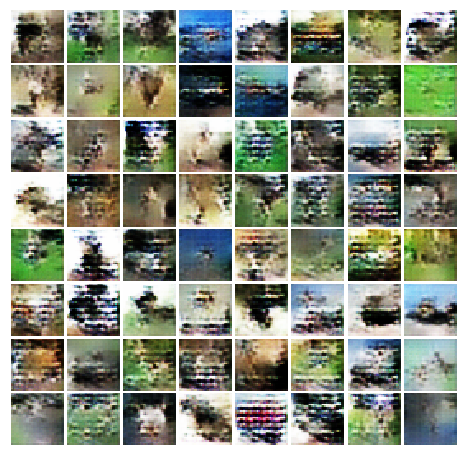


Iter: 2500, D: 0.3557, G:3.149
### (64, 3, 1024)


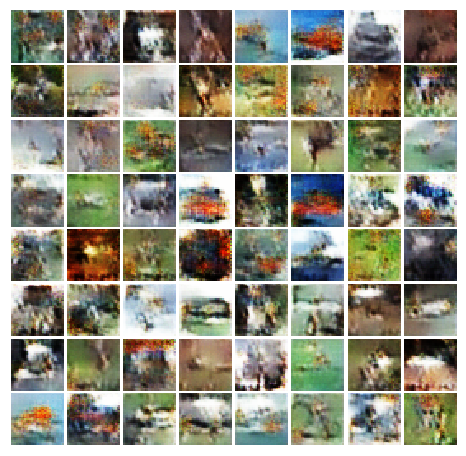


Iter: 2600, D: 0.2829, G:3.884
### (64, 3, 1024)


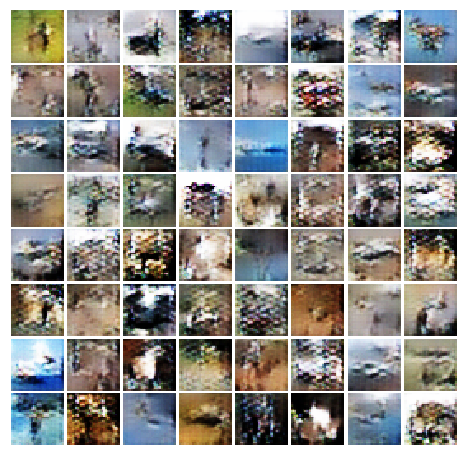


Iter: 2700, D: 0.3987, G:3.502
### (64, 3, 1024)


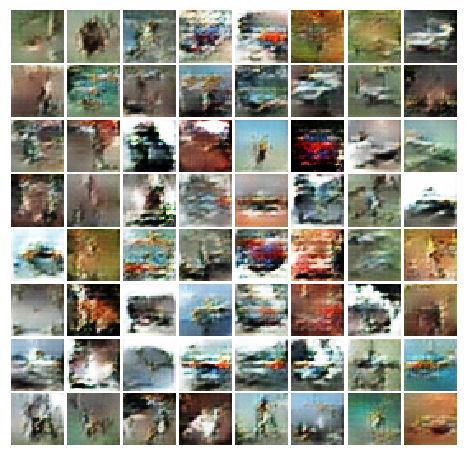


Iter: 2800, D: 0.2785, G:2.703
### (64, 3, 1024)


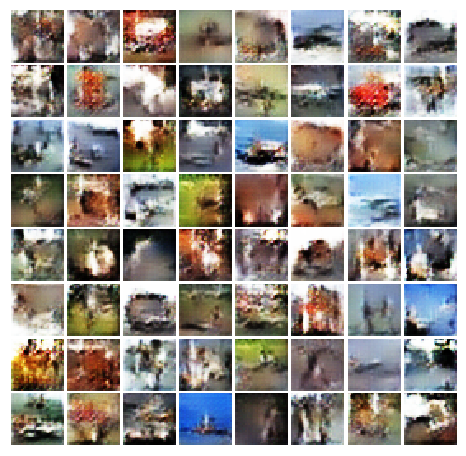


Iter: 2900, D: 0.2463, G:3.913
### (64, 3, 1024)


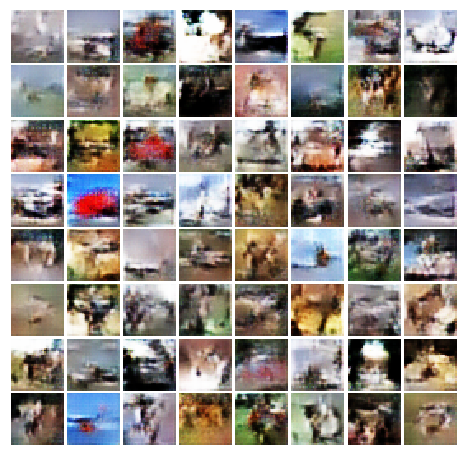


Iter: 3000, D: 0.08964, G:4.786
### (64, 3, 1024)


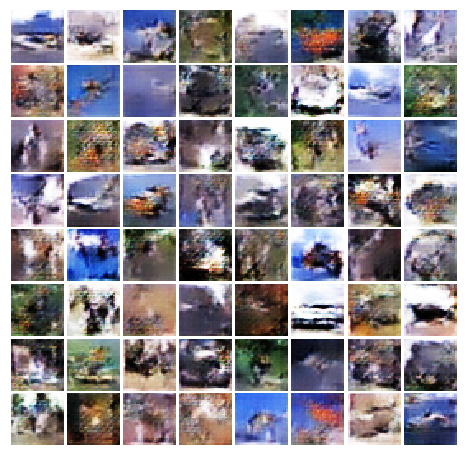


Iter: 3100, D: 0.7122, G:7.32
### (64, 3, 1024)


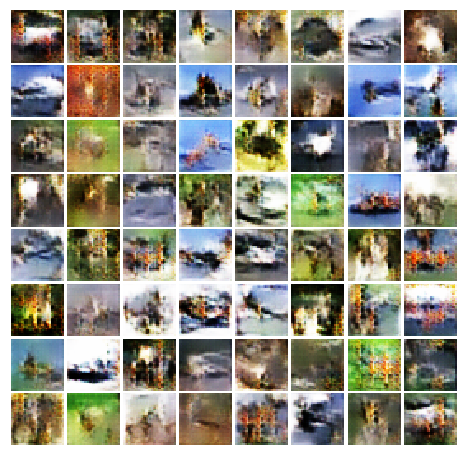


Iter: 3200, D: 0.2257, G:2.887
### (64, 3, 1024)


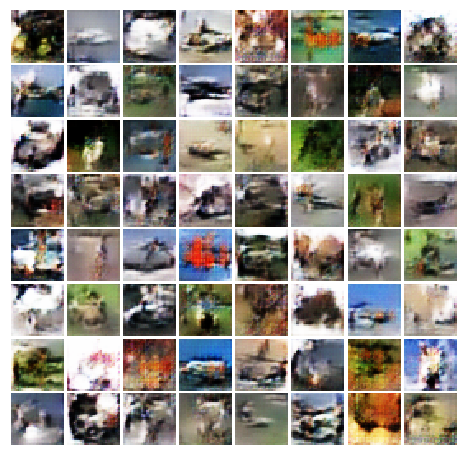


Iter: 3300, D: 0.2641, G:5.439
### (64, 3, 1024)


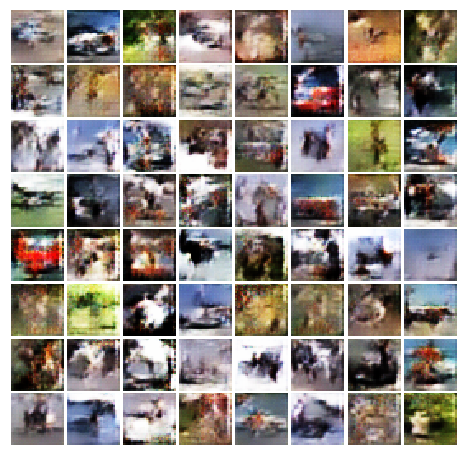


Iter: 3400, D: 0.2434, G:3.56
### (64, 3, 1024)


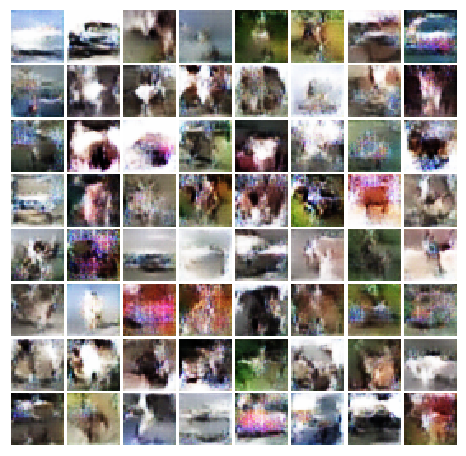


Iter: 3500, D: 0.4468, G:4.045
### (64, 3, 1024)


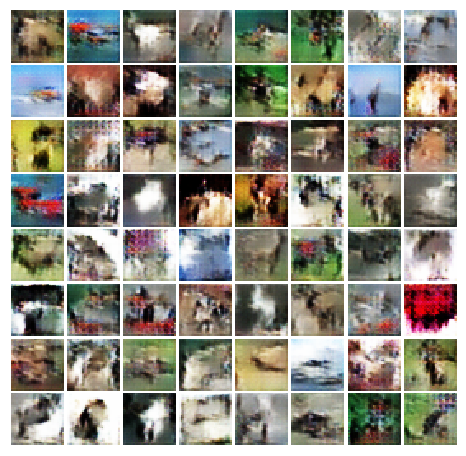


Iter: 3600, D: 0.2414, G:4.964
### (64, 3, 1024)


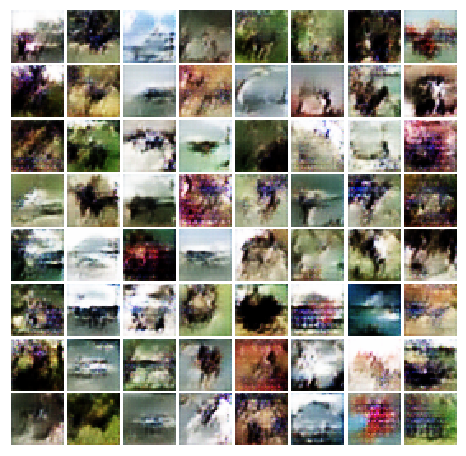


Iter: 3700, D: 0.1781, G:2.927
### (64, 3, 1024)


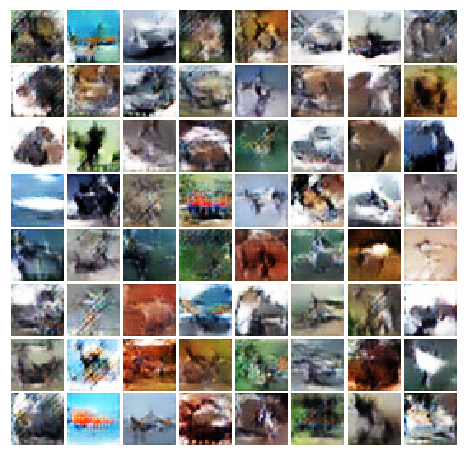


Iter: 3800, D: 0.09128, G:4.716
### (64, 3, 1024)


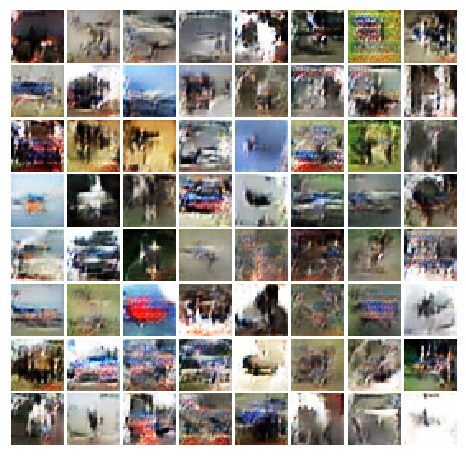


Iter: 3900, D: 0.3529, G:3.212
### (64, 3, 1024)


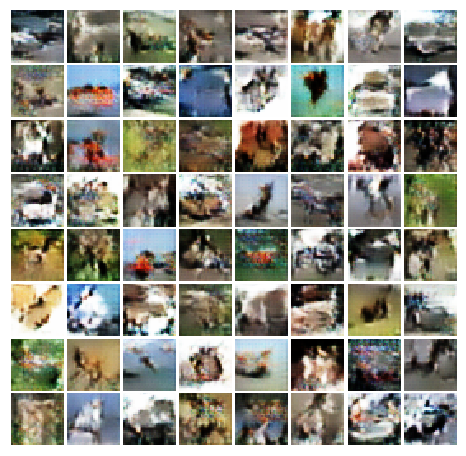


Iter: 4000, D: 0.2231, G:4.218
### (64, 3, 1024)


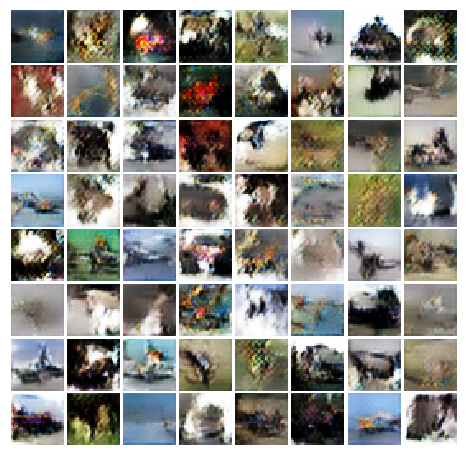


Iter: 4100, D: 0.6207, G:6.553
### (64, 3, 1024)


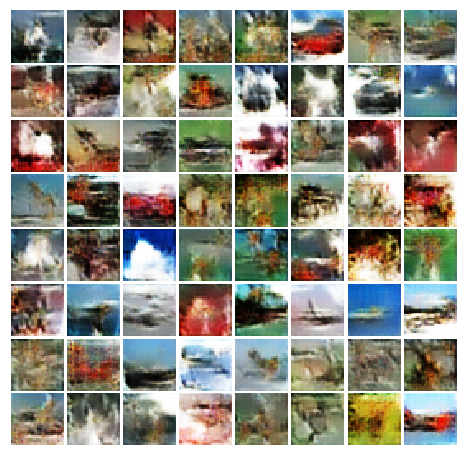


Iter: 4200, D: 0.107, G:4.638
### (64, 3, 1024)


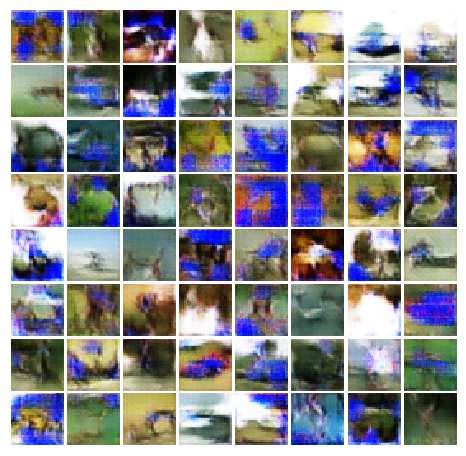


Iter: 4300, D: 0.1416, G:4.059
### (64, 3, 1024)


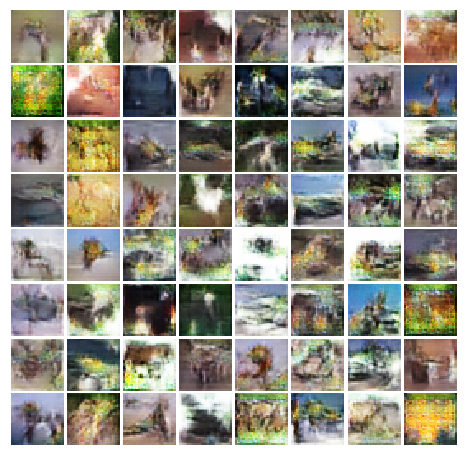


Iter: 4400, D: 0.228, G:3.374
### (64, 3, 1024)


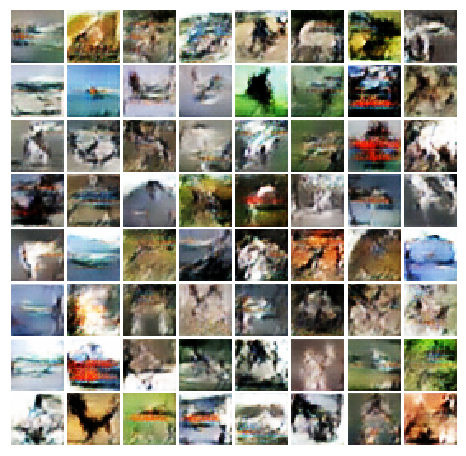


Iter: 4500, D: 0.293, G:3.948
### (64, 3, 1024)


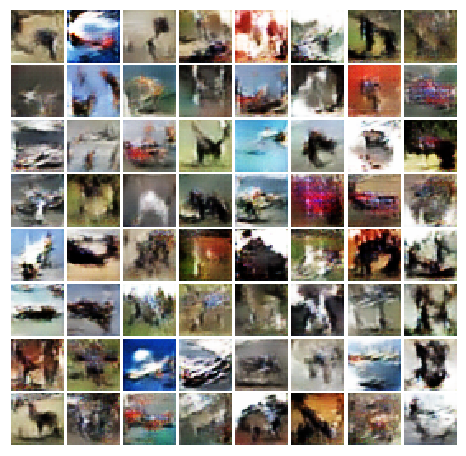


Iter: 4600, D: 0.2047, G:3.396
### (64, 3, 1024)


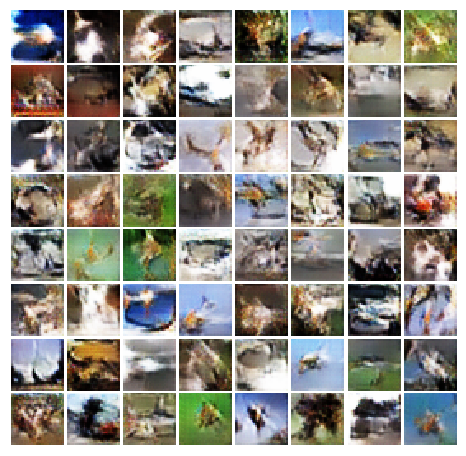


Iter: 4700, D: 0.1403, G:3.82
### (64, 3, 1024)


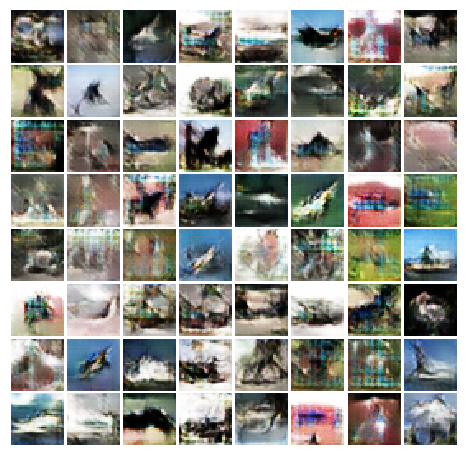


Iter: 4800, D: 0.463, G:4.984
### (64, 3, 1024)


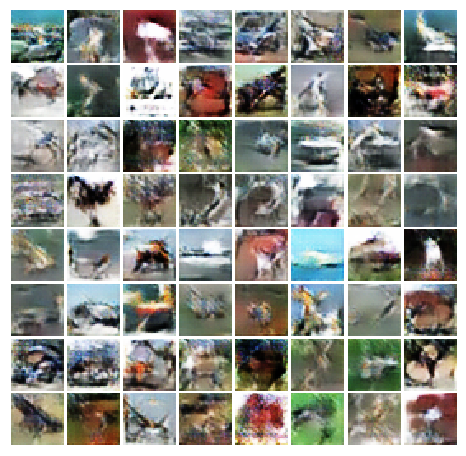


Iter: 4900, D: 0.3822, G:4.155
### (64, 3, 1024)


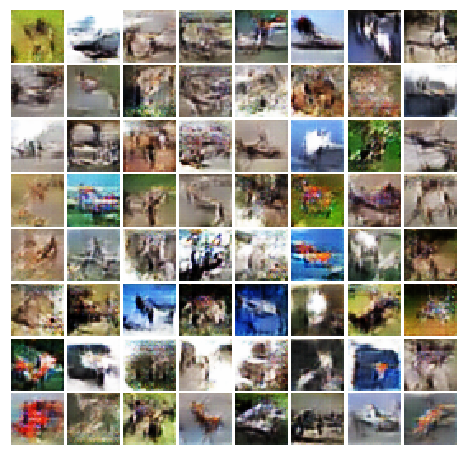


Iter: 5000, D: 0.1794, G:3.619
### (64, 3, 1024)


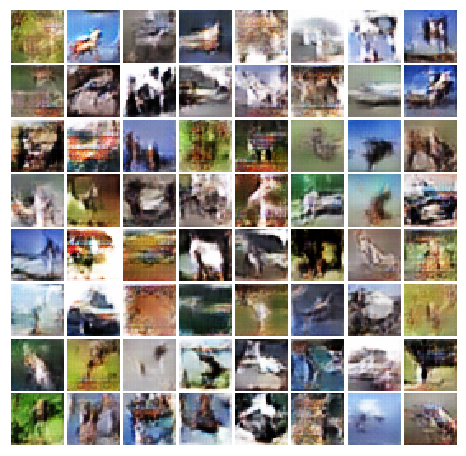


Iter: 5100, D: 0.1165, G:2.954
### (64, 3, 1024)


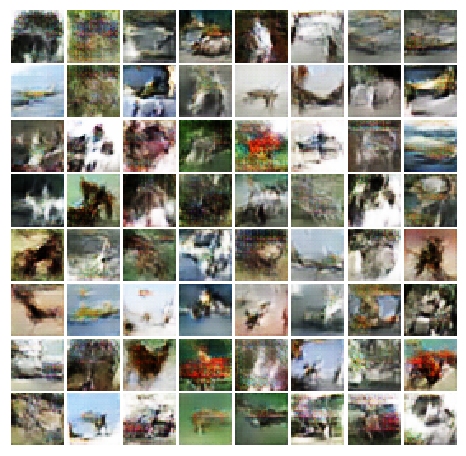


Iter: 5200, D: 0.1656, G:3.086
### (64, 3, 1024)


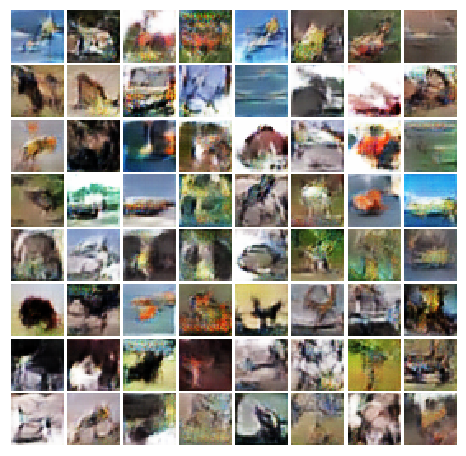


Iter: 5300, D: 0.9683, G:7.67
### (64, 3, 1024)


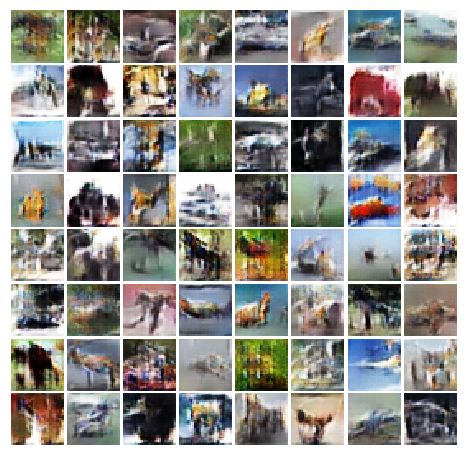


Iter: 5400, D: 0.288, G:4.227
### (64, 3, 1024)


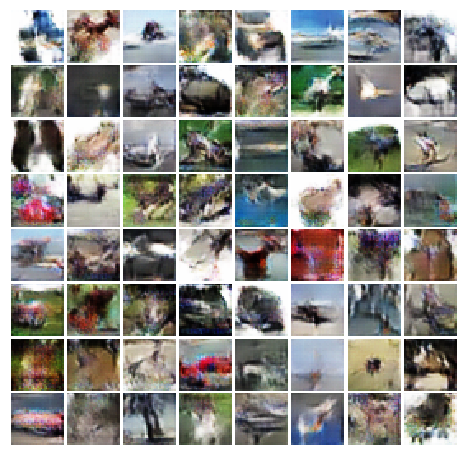


Iter: 5500, D: 0.141, G:3.687
### (64, 3, 1024)


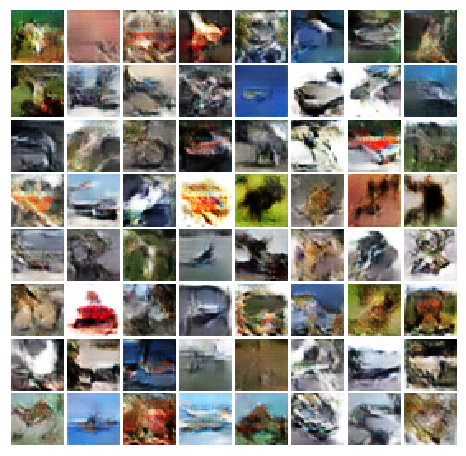


Iter: 5600, D: 0.2302, G:2.707
### (64, 3, 1024)


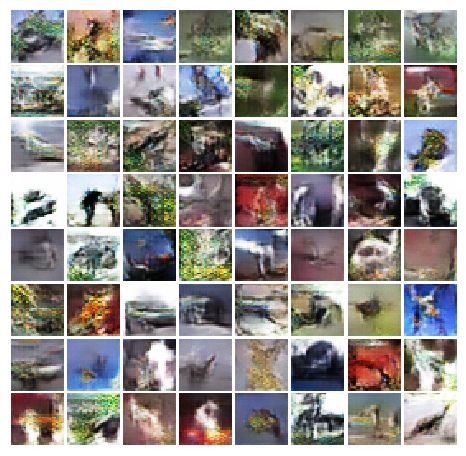


Iter: 5700, D: 0.2007, G:4.836
### (64, 3, 1024)


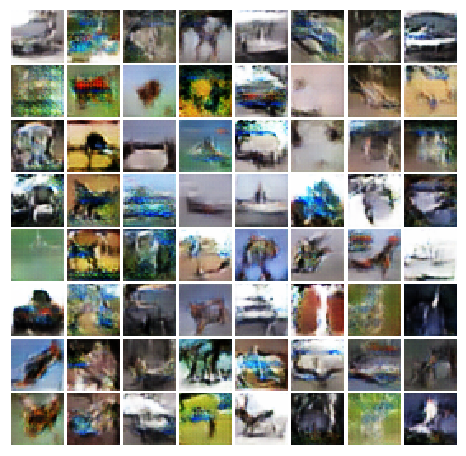


Iter: 5800, D: 0.2084, G:4.112
### (64, 3, 1024)


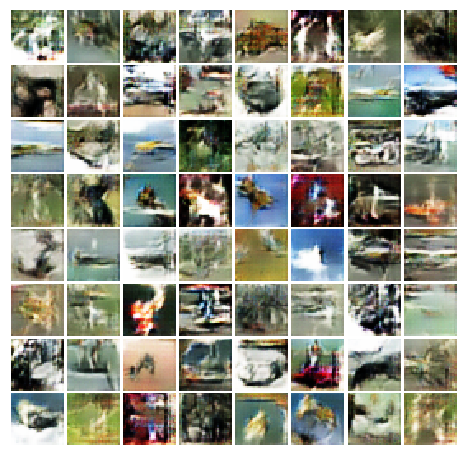


Iter: 5900, D: 0.2054, G:3.509
### (64, 3, 1024)


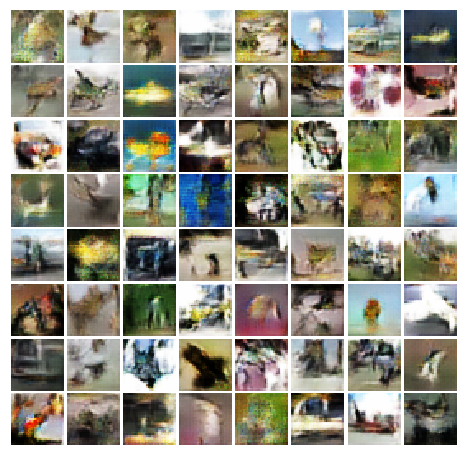


Iter: 6000, D: 0.1667, G:3.75
### (64, 3, 1024)


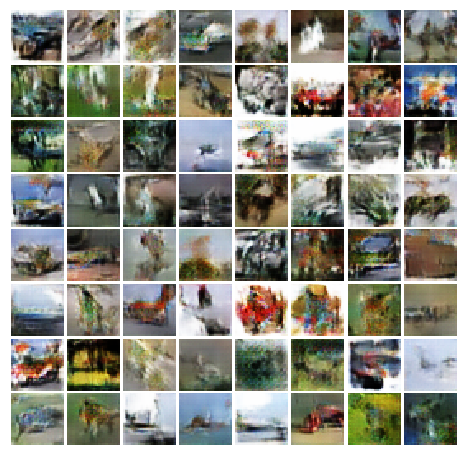


Iter: 6100, D: 0.1573, G:3.833
### (64, 3, 1024)


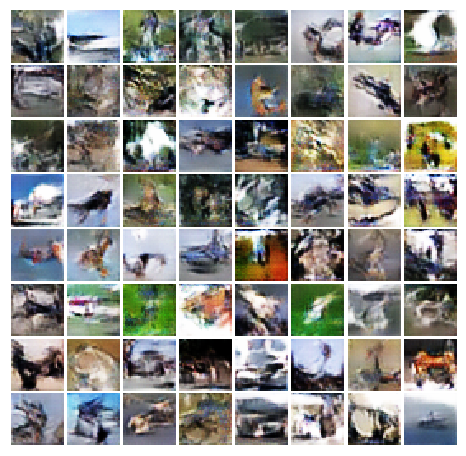


Iter: 6200, D: 0.2454, G:4.073
### (64, 3, 1024)


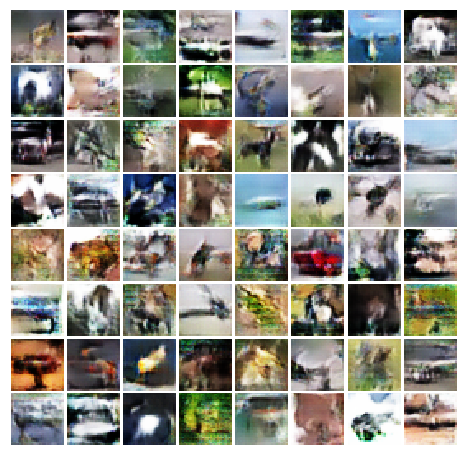


Iter: 6300, D: 0.1811, G:3.373
### (64, 3, 1024)


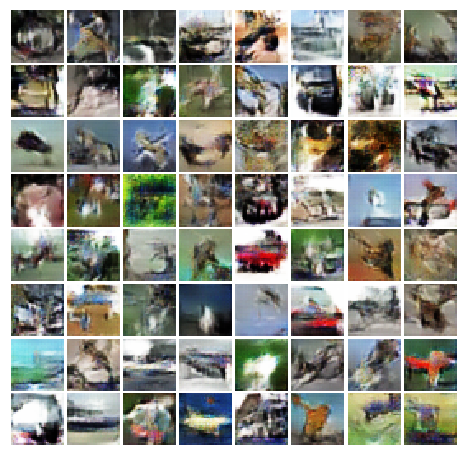


Iter: 6400, D: 0.9612, G:8.912
### (64, 3, 1024)


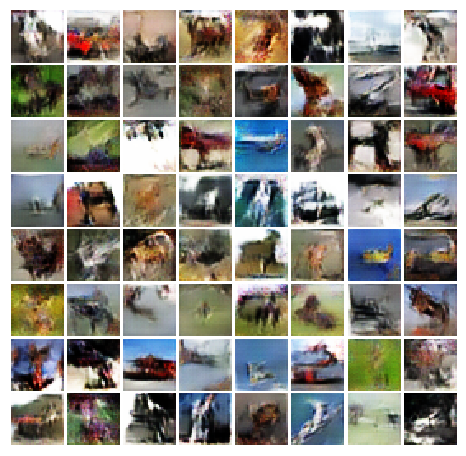


Iter: 6500, D: 0.1252, G:4.083
### (64, 3, 1024)


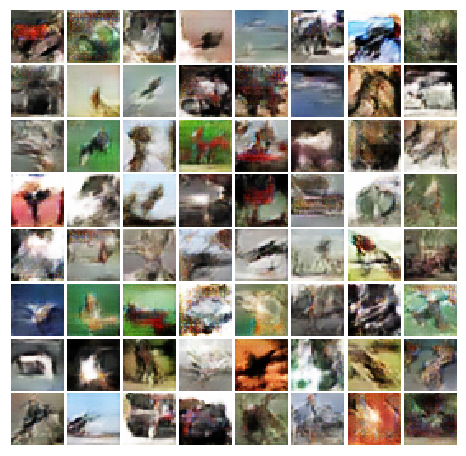


Iter: 6600, D: 0.111, G:3.701
### (64, 3, 1024)


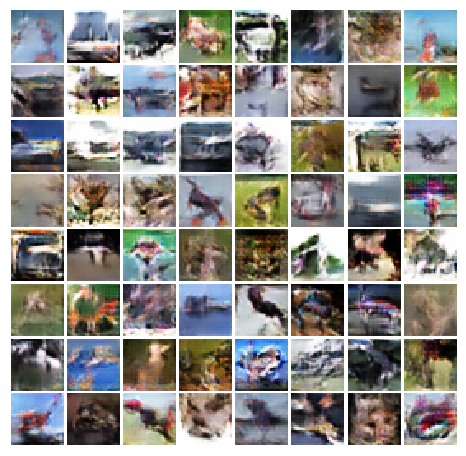


Iter: 6700, D: 0.1388, G:3.152
### (64, 3, 1024)


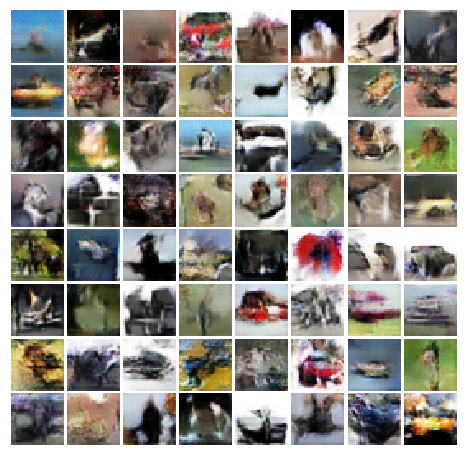


Iter: 6800, D: 0.2735, G:4.103
### (64, 3, 1024)


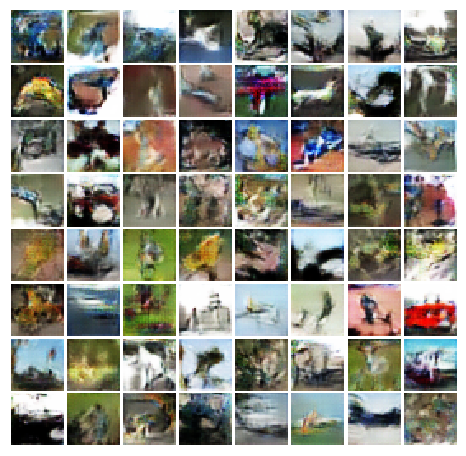


Iter: 6900, D: 0.1114, G:3.909
### (64, 3, 1024)


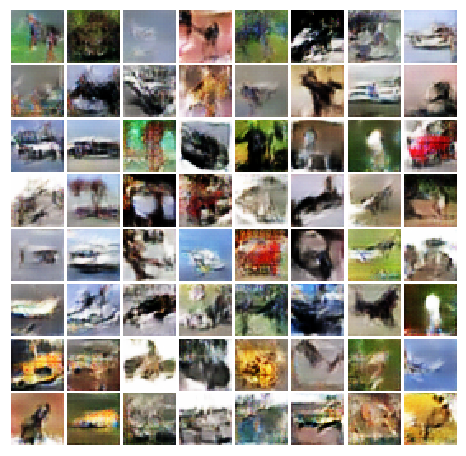


Iter: 7000, D: 0.1583, G:3.578
### (64, 3, 1024)


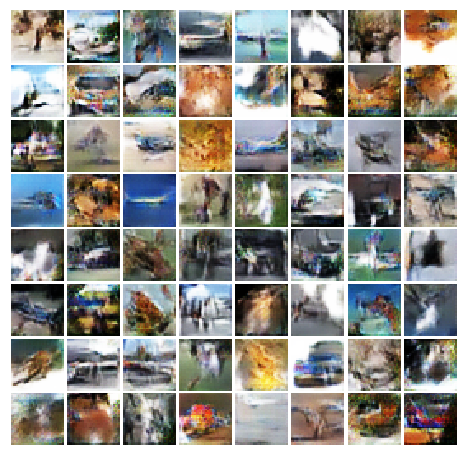


Iter: 7100, D: 0.3938, G:2.284
### (64, 3, 1024)


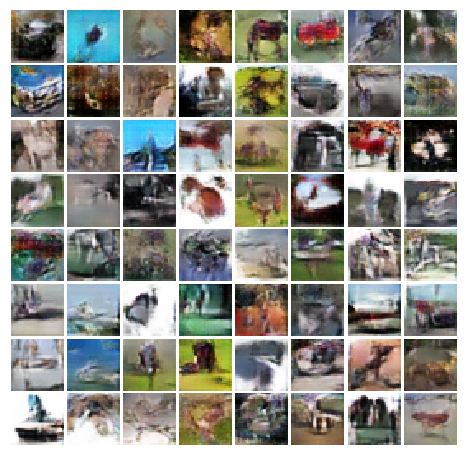


Iter: 7200, D: 0.113, G:3.143
### (64, 3, 1024)


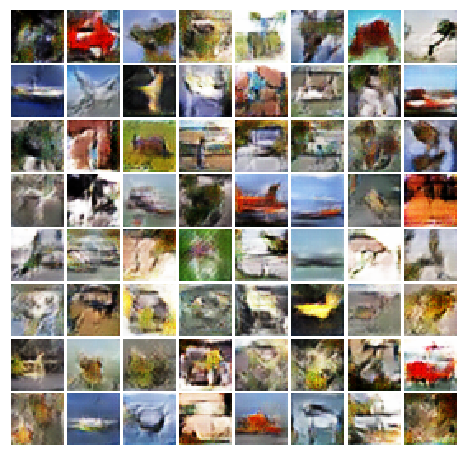


Iter: 7300, D: 0.1908, G:4.078
### (64, 3, 1024)


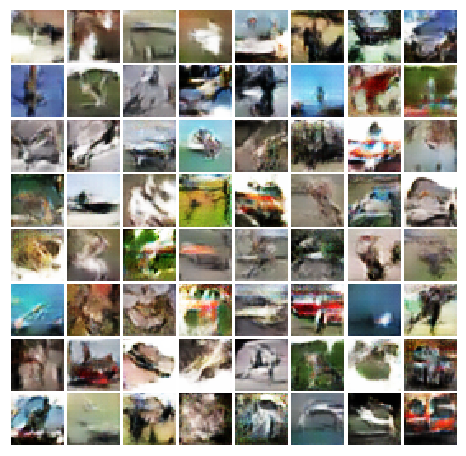


Iter: 7400, D: 0.1606, G:4.685
### (64, 3, 1024)


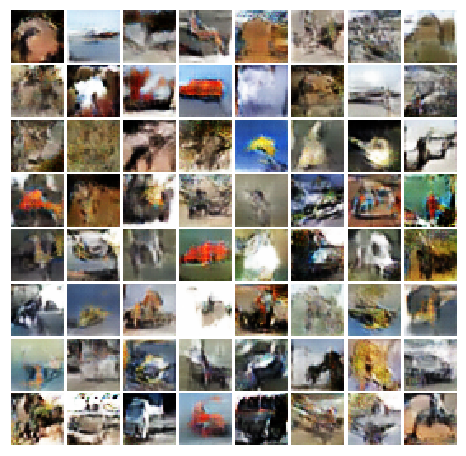


Iter: 7500, D: 0.109, G:4.339
### (64, 3, 1024)


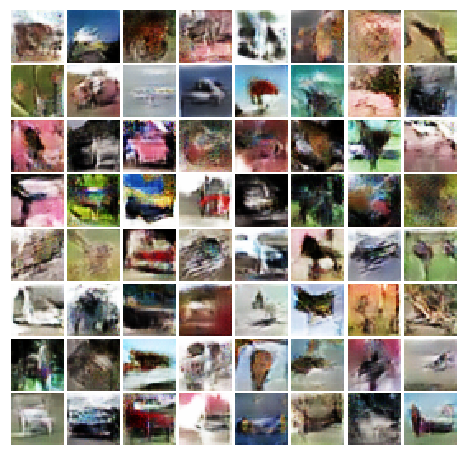


Iter: 7600, D: 0.1463, G:3.47
### (64, 3, 1024)


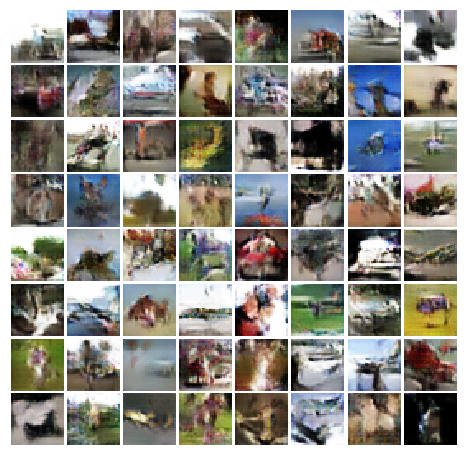


Iter: 7700, D: 0.2829, G:3.622
### (64, 3, 1024)


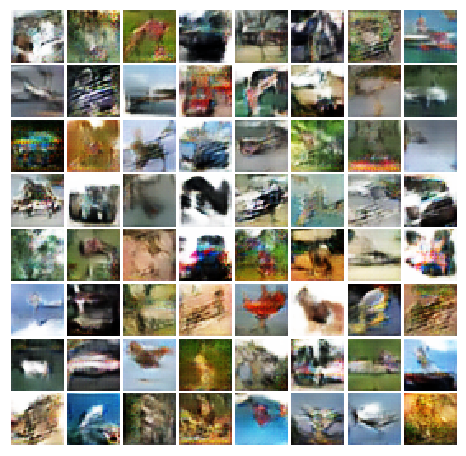


Iter: 7800, D: 0.46, G:5.199
### (64, 3, 1024)


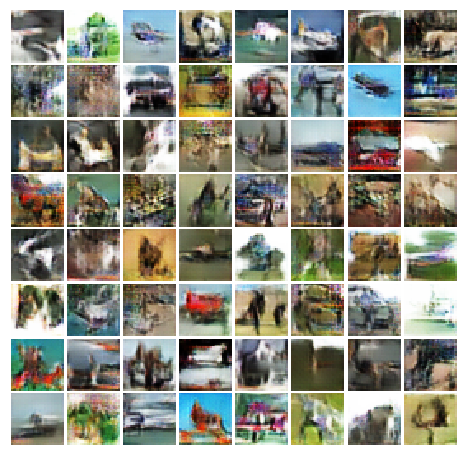

In [11]:
train_dc_gan(D_DC, G_DC, D_DC_optim, G_DC_optim, discriminator_loss, generator_loss, num_epochs=10)